# Notebook For Running MISalign

Included changes:
- Updated model module
    - offset > relations
    - project > mis_file
    - ipy/ipympl alignment GUI
- TODO:
    - canvas rendering


# First Time Setup

## Select Image Files

In [4]:
from os import listdir
from os.path import join, abspath
# source of images

###
folder_path=r"example\data\set_a"
###

# restricts to just files that match the ending you provide.
###
file_ending="jpg"#.tif files
###
file_names=[x for x in listdir(folder_path) if x.split(".")[1]==file_ending]
print(file_names)
# combines images with folder to get absolute path for each.
file_paths=[abspath(join(folder_path,x)) for x in file_names]
print(file_paths)

['a_myimages01.jpg', 'a_myimages02.jpg', 'a_myimages03.jpg', 'a_myimages04.jpg', 'a_myimages05.jpg', 'a_myimages06.jpg', 'a_myimages07.jpg', 'a_myimages08.jpg', 'a_myimages09.jpg', 'a_myimages10.jpg']
['c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages01.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages02.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages03.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages04.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages05.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages06.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages07.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages08.jpg'

## Create mis_file from Image Paths

In [5]:
from MISalign.model.mis_file import MisFile,save_mis

In [6]:
###
mis_fp=join(folder_path,"mymis.mis")
###

In [ ]:
mis_project=MisFile(image_fps=file_paths)
print(mis_project)
save_mis(mis_fp,mis_project)

# Alignment

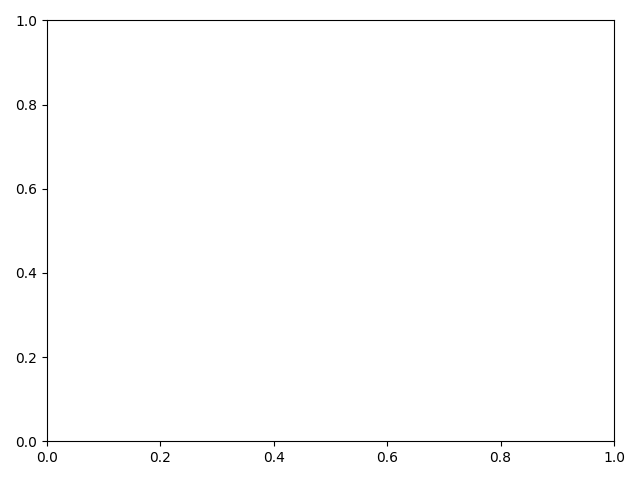

In [3]:
from MISalign.alignment.interactive_manual import IMRControls
%matplotlib widget
imrc=IMRControls(mis_project)

In [4]:
mis_project=imrc.get_mis()
print(mis_project)

A MISalign project with:[['c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages01.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages02.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages03.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages04.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages05.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages06.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages07.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages08.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\set_a\\a_myimages09.jpg', 'c:\\Users\\drago\\Documents\\MISaligned\\MISalign_public\\example\\data\\

In [5]:
del imrc._images #free up memory.

# Save/Load

In [7]:
from MISalign.model.mis_file import load_mis

In [8]:
mis_project=load_mis(mis_fp)

In [6]:
save_mis(mis_fp,mis_project)

In [ ]:
#TODO load mis from file
#TODO tbd

# Canvas

In [9]:
from MISalign.canvas.canvas_solve import rectangular_solve
relations=mis_project.get_rels('r')
image_names=mis_project.get_image_names()
origin="a_myimages01.jpg"
origin_relative_offsets=rectangular_solve(
    relations=relations,
    image_names=image_names,
    origin=origin
)
display(origin_relative_offsets)

{'a_myimages01.jpg': (0, 0),
 'a_myimages02.jpg': (12, -1088),
 'a_myimages03.jpg': (20, -2229),
 'a_myimages04.jpg': (-109, -3287),
 'a_myimages05.jpg': (-98, -4230),
 'a_myimages06.jpg': (-93, -5090),
 'a_myimages07.jpg': (-83, -6080),
 'a_myimages08.jpg': (-74, -7089),
 'a_myimages09.jpg': (-65, -8028),
 'a_myimages10.jpg': (-62, -8750)}

In [10]:
import MISalign.canvas.canvas_render as cr
image_filepaths={k:v for k,v in zip(mis_project.get_image_names(),mis_project.get_image_names())}
image_sizes=cr.find_image_sizes(image_filepaths)
origin_relative_extents=cr.find_relative_extents(
    image_names=image_names,
    origin_relative_offsets=origin_relative_offsets,
    image_sizes=image_sizes)
canvas_extents, canvas_offsets=cr.resolve_extents(origin_relative_extents)
canvas_relative_offsets=cr.place_in_canvas(
    image_names,
    origin_relative_offsets,
    canvas_extents,
    canvas_offsets)

In [ ]:
unblended_canvas=cr.render_unblended(
    image_names,
    image_filepaths,
    image_sizes,
    canvas_relative_offsets,
    canvas_extents)
display(unblended_canvas)

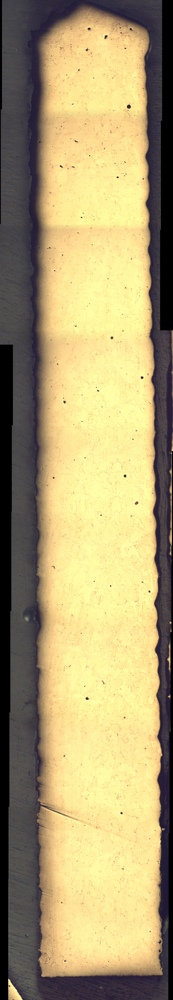

In [13]:
dfe_normalizer=cr.build_normalization(
    image_names,
    image_sizes,
    canvas_relative_offsets,
    canvas_extents,
    cr.weight_dfe)
blended_canvas_dfe=cr.render_blended(
    image_names,
    image_filepaths,
    image_sizes,
    canvas_relative_offsets,
    canvas_extents,
    cr.weight_dfe,
    dfe_normalizer)
display(blended_canvas_dfe)

In [ ]:
flat_normalizer=cr.build_normalization(
    image_names,
    image_sizes,
    canvas_relative_offsets,
    canvas_extents,
    cr.weight_flat)
blended_canvas_flat=cr.render_blended(
    image_names,
    image_filepaths,
    image_sizes,
    canvas_relative_offsets,
    canvas_extents,
    cr.weight_flat,
    flat_normalizer)
display(blended_canvas_flat)